# __TRANSFORMADAS GEOMÉTRICAS__
---
>## __Computación gráfica__

---

## __CONTENIDO__
>- Transformaciones básicas
    - Traslación
    - Rotación
    - Escala
    - Reflexión
- Transformadas inversas
- Coordenadas homogéneas
- Transformaciones compuestas
    - Traslación compuesta
    - Rotación compuesta
    - Escala compuesta
    - Rotación con pivote
    - Escala con punto fijo
    - Reflexión 2D con una recta
    - Rotación libre
- Proyección de la cámara
- Proyección en perspectiva


# Traslación 3D: 
# __$T(\Delta x, \Delta y, \Delta z)$__

- $x' = x + \Delta x$
- $y' = y + \Delta y$
- $z' = z + \Delta z$

---
$$P' = T(\Delta x, \Delta y, \Delta z) \cdot P$$ <br>
Operación: _row major_:  <br>
Los componentes $(x,y,z)$ se organizan por filas <br><br>
$$
\begin{bmatrix}
 x'\\ 
 y'\\ 
 z'\\ 
 h 
\end{bmatrix}
= 
\begin{bmatrix}
 1&  0&  0& \Delta x \\ 
 0&  1&  0& \Delta y\\ 
 0&  0&  1& \Delta z\\ 
 0&  0&  0& 1
\end{bmatrix}
⋅
\begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}
$$

---

## __Trasponer la operación de matrices__ (_column major_)
> - En _column major_ los componentes $(x,y,z)$ se organizan por columnas: <br><br>
$$P'^T =  P^T \cdot T(\Delta x, \Delta y, \Delta z)^T$$ <br><br>
$$
\begin{bmatrix}
 x' & y' & z' & h 
\end{bmatrix}
= 
\begin{bmatrix}
 x &  y & z & 1 
\end{bmatrix}
⋅
\begin{bmatrix}
 1&  0&  0& 0 \\ 
 0&  1&  0& 0 \\ 
 0&  0&  1& 0 \\ 
 \Delta x&  \Delta y&  \Delta z& 1
\end{bmatrix}
$$
<br>
> - Para ver mas ejemplos de multiplicación de matrices por filas o columnas ingrese al [enlace](https://www.scratchapixel.com/lessons/mathematics-physics-for-computer-graphics/geometry/row-major-vs-column-major-vector)

## __Operación con n puntos__
> - La operación de arriba se hace con un punto, pero si tienen $n$ puntos organizados en una matriz, donde los componentes $(x, y, z)$ vienen en columnas, se puede hacer: 

$$P'^T =  P^T \cdot T(\Delta x, \Delta y, \Delta z)^T$$ <br><br>
$$
\begin{bmatrix}
 x'_1 & y'_1 & z'_1 & h \\
x'_2 & y'_2 & z'_2 & h \\
... \\
x'_n & y'_n & z'_n & h 
\end{bmatrix}
= 
\begin{bmatrix}
 x_1 &  y_1 & z_1 & 1 \\
 x_2 &  y_2 & z_2 & 1 \\
 ... \\
 x_n &  y_n & z_n & 1 \\
\end{bmatrix}
⋅
\begin{bmatrix}
 1&  0&  0& 0 \\ 
 0&  1&  0& 0 \\ 
 0&  0&  1& 0 \\ 
 \Delta x&  \Delta y&  \Delta z& 1
\end{bmatrix}
$$


# Traslación inversa 3D: 
# __$ T^{-1}(\Delta x, \Delta y, \Delta z)$__

- $x' = x - \Delta x$
- $y' = y - \Delta y$
- $z' = z - \Delta z$

---
$$P' = T^{-1}(\Delta x, \Delta y, \Delta z) \cdot P$$ <br><br>
$$
\begin{bmatrix}
 x'\\ 
 y'\\ 
 z'\\ 
 h 
\end{bmatrix}
= 
\begin{bmatrix}
 1&  0&  0& -\Delta x \\ 
 0&  1&  0& -\Delta y\\ 
 0&  0&  1& -\Delta z\\ 
 0&  0&  0& 1
\end{bmatrix}
⋅
\begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}
$$

matriz puntos P: (8, 4)
[[-1.  -0.5  0.   1. ]
 [ 0.  -0.5  0.   1. ]
 [ 0.  -1.   0.   1. ]
 [ 1.   0.   0.   1. ]
 [ 0.   1.   0.   1. ]
 [ 0.   0.5  0.   1. ]
 [-1.   0.5  0.   1. ]
 [-1.  -0.5  0.   1. ]]


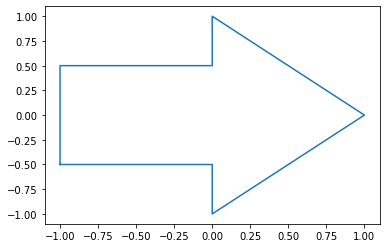

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

P = np.array([[-1, -0.5, 0, 1], 
              [ 0, -0.5, 0, 1], 
              [ 0,   -1, 0, 1], 
              [ 1,    0, 0, 1],  
              [ 0,    1, 0, 1], 
              [ 0,  0.5, 0, 1], 
              [-1,  0.5, 0, 1], 
              [-1, -0.5, 0, 1]])

plt.plot(P[:,0], P[:,1])
print('matriz puntos P:', P.shape)
print(P)

array([[  1,   0,   0,   0],
       [  0,   1,   0,   0],
       [  0,   0,   1,   0],
       [ -2,   1, -15,   1]])

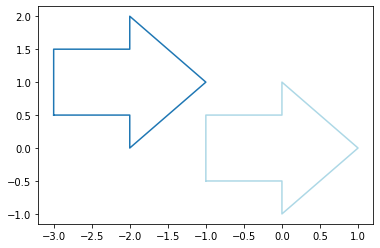

In [ ]:
def traslacion(dx, dy, dz):
    return np.array([[1, 0, 0, dx], 
                     [0, 1, 0, dy], 
                     [0, 0, 1, dz], 
                     [0, 0, 0,  1]]).T

T = traslacion(-2, 1, -15)
P1 = np.matmul(P, T)
plt.plot(P[:,0], P[:,1], 'lightblue')
plt.plot(P1[:,0], P1[:,1])
T

# Rotación 2D
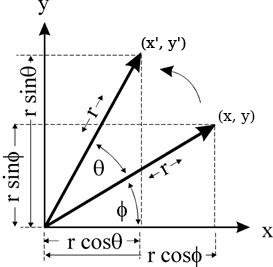

__Deducción de la matriz de rotación 2D.__
> - $x = R \cos(\phi)$
- $y = R \sin(\phi)$ <br><br>
- $x' = R \cos(\theta+\phi)$
- $y' = R \sin(\theta+\phi)$ <br><br>
- $x' = R \cos(\theta)\cos(\phi) - R \sin(\theta)\sin(\phi)$
- $y' = R \sin(\theta)\cos(\phi) + R \cos(\theta)\sin(\phi)$

----
> Finalmente, queda: 
- $x' = x \cos(\theta) - y \sin(\theta)$
- $y' = x \sin(\theta) + y \cos(\theta)$

---
## La rotación 3D $R(θ)$
$$P' = R(\theta)\cdot P$$ <br><br>
$$
\begin{bmatrix}
 x'\\ 
 y'\\ 
 z'\\ 
 h 
\end{bmatrix}
= 
\begin{bmatrix}
 \cos(\theta)  &-\sin(\theta)  & 0 & 0 \\ 
 \sin(\theta) &\cos(\theta)  &0  &0 \\ 
 0&  0& 1  &0 \\ 
 0& 0 & 0 & 1
\end{bmatrix}
\cdot \begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}$$

# Rotación inversa 3D
# __$R^{-1}(\theta)$__


- $x' = x \cos(\theta) + y \sin(\theta)$
- $y' = -x \sin(\theta) + y \cos(\theta)$

---
$$P' = R^{-1}(\theta) \cdot P$$ <br><br>
$$
\begin{bmatrix}
 x'\\ 
 y'\\ 
 z'\\ 
 h 
\end{bmatrix}
= 
\begin{bmatrix}
 \cos(\theta)  &\sin(\theta)  & 0 & 0 \\ 
 -\sin(\theta) &\cos(\theta)  &0  &0 \\ 
 0&  0& 1  &0 \\ 
 0& 0 & 0 & 1
\end{bmatrix}
\cdot \begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}$$

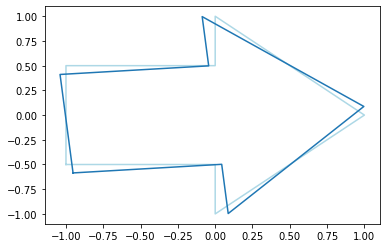

In [ ]:
def rotacion(ang):
    c = np.cos(ang)
    s = np.sin(ang)
    return np.array([[c, -s, 0, 0], 
                     [s,  c, 0, 0], 
                     [0,  0, 1, 0], 
                     [0,  0, 0, 1]]).T

R = rotacion(5*np.pi/180)
P1 = np.matmul(P, R)
plt.plot(P[:,0], P[:,1], 'lightblue')
plt.plot(P1[:,0], P1[:,1])

# Escala 3D
# __$S(S_x, S_y, S_z)$__

> - $x' = S_x x$
- $y' = S_y y$
- $z' = S_z z$

---
$$ P' = S(S_x, S_y, S_z)\cdot P$$
$$
\begin{bmatrix}
 x'\\ 
 y'\\ 
 z'\\ 
 h 
\end{bmatrix} = 
\begin{bmatrix}
 S_x&  0&  0& 0 \\
 0&  S_y&  0& 0\\ 
 0&  0&  S_z& 0\\ 
 0&  0&  0& 1
\end{bmatrix} \cdot
\begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}$$

# Escala inversa 3D
# __$S^{-1}(S_x, S_y, S_z)$__

> - $x' = \frac{1}{S_x} x$
- $y' = \frac{1}{S_y} y$
- $z' = \frac{1}{S_z} z$

---
$$ P' = S^{-1}(S_x, S_y, S_z) \cdot P$$ <br><br>
$$
\begin{bmatrix}
 x'\\ 
 y'\\ 
 z'\\ 
 h 
\end{bmatrix} = 
\begin{bmatrix}
 1/S_x&  0&  0& 0 \\
 0&  1/S_y&  0& 0\\ 
 0&  0&  1/S_z& 0\\ 
 0&  0&  0& 1
\end{bmatrix} \cdot
\begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}$$

(-9.9, 9.9, -9.9, 9.9)

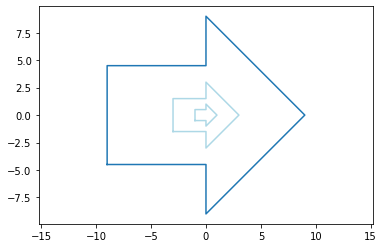

In [ ]:
def escala(sx, sy, sz):
    return np.array([[sx,  0,  0, 0], 
                     [ 0, sy,  0, 0], 
                     [ 0,  0, sz, 0], 
                     [ 0,  0,  0, 1]]).T

S = escala(3, 3, 1)
P1 = np.matmul(P, S)
plt.plot(P[:,0], P[:,1], 'lightblue')
plt.plot(P1[:,0], P1[:,1], 'lightblue')
P2 = np.matmul(P1, S)
plt.plot(P2[:,0], P2[:,1])
plt.axis('equal')

# Reflexión en el eje x

> - $x' = x$
- $y' = -y$

# Reflexión en el eje y

> - $x' = -x$
- $y' = y$


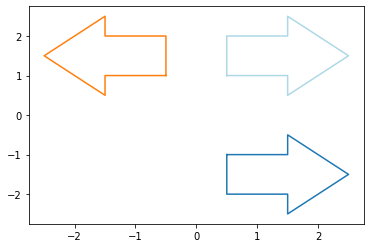

In [ ]:
def reflexionX():
    return np.array([[1,  0, 0, 0], 
                     [0, -1, 0, 0], 
                     [0,  0, 1, 0], 
                     [0,  0, 0, 1]]).T

def reflexionY():
    return np.array([[-1, 0, 0, 0], 
                     [ 0, 1, 0, 0], 
                     [ 0, 0, 1, 0], 
                     [ 0, 0, 0, 1]]).T

T = traslacion(1.5, 1.5, 1)
P1 = np.matmul(P, T)
Xx = reflexionX()
P2 = np.matmul(P1, Xx)
plt.plot(P1[:,0], P1[:,1], 'lightblue')
plt.plot(P2[:,0], P2[:,1])
Xy = reflexionY()
P3 = np.matmul(P1, Xy)
plt.plot(P3[:,0], P3[:,1])

# __Rotación 3D sobre el eje X, Y__

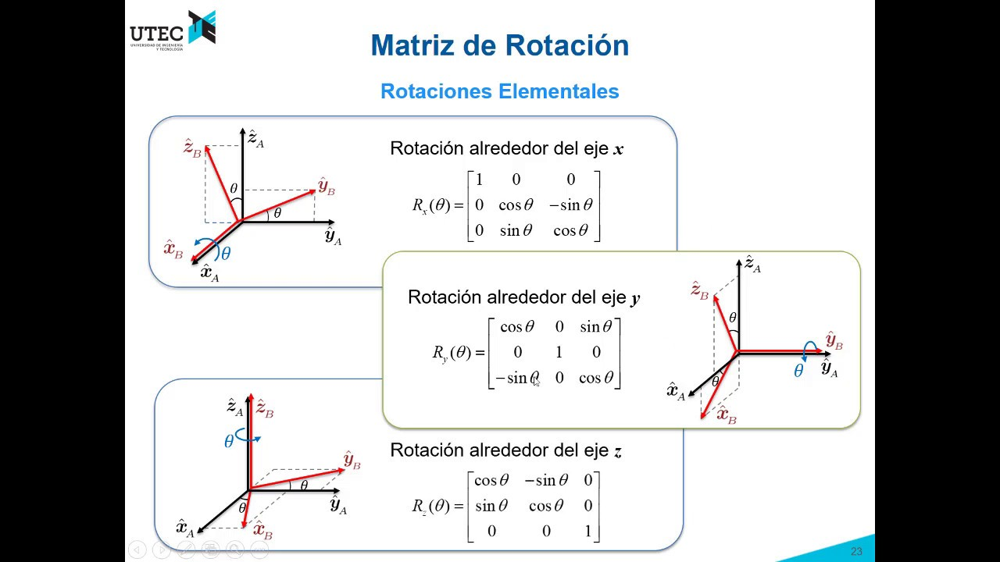

In [ ]:
def rotacionX(ang):
    c = np.cos(ang)
    s = np.sin(ang)
    return np.array([[1, 0,  0, 0], 
                     [0, c, -s, 0], 
                     [0, s,  c, 0], 
                     [0, 0,  0, 1]]).T

def rotacionY(ang):
    c = np.cos(ang)
    s = np.sin(ang)
    return np.array([[c, 0, -s, 0], 
                     [0, 1,  0, 0], 
                     [s, 0,  c, 0], 
                     [0, 0,  0, 1]]).T

[[-1 -1 -1  1]
 [-1 -1  1  1]
 [ 1 -1  1  1]
 [ 1 -1 -1  1]
 [-1 -1 -1  1]
 [ 0  1  0  1]
 [ 1 -1  1  1]
 [-1 -1  1  1]
 [ 0  1  0  1]
 [ 1 -1 -1  1]]


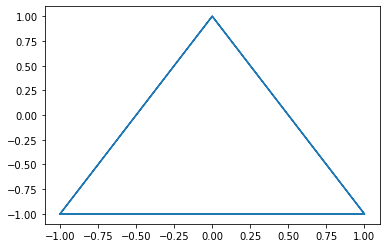

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
V = [[-1, -1, -1, 1], [-1, -1, 1, 1], [1, -1, 1, 1], [1, -1, -1, 1], [-1, -1, -1, 1], 
     [0, 1, 0, 1], [1, -1, 1, 1], [-1, -1, 1, 1], [0, 1, 0, 1], [1, -1, -1, 1]]
V = np.array(V)
plt.plot(V[:,0], V[:, 1])
print(V)

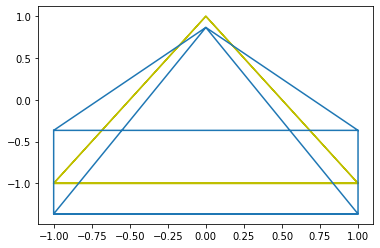

In [ ]:
R =  rotacionX(np.pi/6)
v1 = np.matmul(V, R)
plt.plot(V[:,0], V[:,1], 'y')
plt.plot(v1[:,0], v1[:,1])

In [ ]:
# animación
from matplotlib import animation, rc

fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-2, 2))
ax.set_ylim((-2, 2))
points, = ax.plot(V[:,0], V[:,1])

def rotate_figure(c, mp, puntos):
  R = rotacionX(np.pi*c/60)
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos

# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(V, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

In [ ]:
fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-2, 2))
ax.set_ylim((-2, 2))
points, = ax.plot(V[:,0], V[:,1])

def rotate_figure(c, mp, puntos):
  R = rotacionY(np.pi*c/60)
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos

# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(V, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

# Composición de traslación

$P' = (T(x_1,y_1,z_1)\cdot P ) + T(x_2, y_2, z_2)\cdot P$

> - $P' = T_1 \cdot T_2 \cdot P$
- $x' = (x_1 + x_2) + x$
- $y' = (y_1 + y_2) + y$
- $z' = (z_1 + z_2) + z$


In [ ]:
T1 = traslacion(1,2,3)
T2 = traslacion(2,4,-2)
print('T1 = \n', T1)
print('T2 = \n', T2)
T = np.matmul(T1, T2)
print('T1*T2 = \n', T)

T1 = 
 [[1 0 0 0]
 [0 1 0 0]
 [0 0 1 0]
 [1 2 3 1]]
T2 = 
 [[ 1  0  0  0]
 [ 0  1  0  0]
 [ 0  0  1  0]
 [ 2  4 -2  1]]
T1*T2 = 
 [[1 0 0 0]
 [0 1 0 0]
 [0 0 1 0]
 [3 6 1 1]]


In [ ]:
R1 = rotacion(np.pi/6) # rota 30°
R2 = rotacion(np.pi/4) # rota 45°
print('R1 = \n', R1)
print('R2 = \n', R2)
R = np.matmul(R1, R2)
print('R1*R2 = \n', R)
RC = rotacion(np.pi/6 + np.pi/4)
print('R(ang1+ang2)= \n',RC)

R1 = 
 [[ 0.8660254  0.5        0.         0.       ]
 [-0.5        0.8660254  0.         0.       ]
 [ 0.         0.         1.         0.       ]
 [ 0.         0.         0.         1.       ]]
R2 = 
 [[ 0.70710678  0.70710678  0.          0.        ]
 [-0.70710678  0.70710678  0.          0.        ]
 [ 0.          0.          1.          0.        ]
 [ 0.          0.          0.          1.        ]]
R1*R2 = 
 [[ 0.25881905  0.96592583  0.          0.        ]
 [-0.96592583  0.25881905  0.          0.        ]
 [ 0.          0.          1.          0.        ]
 [ 0.          0.          0.          1.        ]]
R(ang1+ang2)= 
 [[ 0.25881905  0.96592583  0.          0.        ]
 [-0.96592583  0.25881905  0.          0.        ]
 [ 0.          0.          1.          0.        ]
 [ 0.          0.          0.          1.        ]]


In [ ]:
S1 = escala(2,2,2)
S2 = escala(0.5,0.5,0.5)
S = np.matmul(S1, S2)
print(S1)
print(S2)
print(S)

[[2 0 0 0]
 [0 2 0 0]
 [0 0 2 0]
 [0 0 0 1]]
[[0.5 0.  0.  0. ]
 [0.  0.5 0.  0. ]
 [0.  0.  0.5 0. ]
 [0.  0.  0.  1. ]]
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


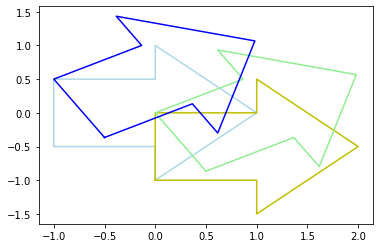

In [ ]:
h = -1 
k = 0.5
ang = np.pi/6
T1 = traslacion(-h, -k, 0)
plt.plot(P[:,0], P[:,1], color='lightblue')
P1 = np.matmul(P, T1)
plt.plot(P1[:,0], P1[:,1], color='y')
R1 = rotacion(ang)
P2 = np.matmul(P1, R1)
plt.plot(P2[:,0], P2[:,1], color='lightgreen')
T2 = traslacion(h, k, 0)
P3 = np.matmul(P2, T2)
plt.plot(P3[:,0], P3[:,1], color='blue')


# ROTACIÓN CON PIVOTE

$R_{pivot} = T^{-1}(-h, -k) * R(ang) * T(h, k)$

In [ ]:
def rotacionPivote(h, k, ang):
    T1 = traslacion(-h, -k, 0)
    R = rotacion(ang)
    T2 = traslacion(h, k, 0)
    return np.matmul(np.matmul(T1, R), T2) 

M = rotacionPivote(-1, 0.5, np.pi/6)
M

array([[ 0.8660254,  0.5      ,  0.       ,  0.       ],
       [-0.5      ,  0.8660254,  0.       ,  0.       ],
       [ 0.       ,  0.       ,  1.       ,  0.       ],
       [ 0.1160254,  0.5669873,  0.       ,  1.       ]])

In [ ]:
# First set up the figure, the axes, and the plot element
fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-5.5, 5.5))
ax.set_ylim((-5.5, 5.5))
points, = ax.plot(P[:,0], P[:,1])

def rotate_figure(c, mp, puntos):
  R = rotacionPivote(2, 2, np.pi*c/60)
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  ax.set_title('Angulo rotación:'+str(c*3))
  #ax.axis('equal')
  return puntos

# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(P, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

In [ ]:
Q = np.random.rand(400, 4)*2-1
Q[:,2] = Q[:,0]**2 - Q[:,1]**2  # Z = X² - Y²
Q[:,3] = 1 # h = 1
Q[0:10, :]

array([[-0.43536621, -0.54327962, -0.10560901,  1.        ],
       [-0.5514996 , -0.50367844,  0.05045984,  1.        ],
       [ 0.97511704, -0.41466968,  0.7789023 ,  1.        ],
       [ 0.07665581,  0.34262394, -0.11151505,  1.        ],
       [ 0.54311547, -0.58276372, -0.04463914,  1.        ],
       [-0.45179291, -0.28462004,  0.12310826,  1.        ],
       [ 0.32257716, -0.65795228, -0.32884518,  1.        ],
       [ 0.65922831, -0.68610837, -0.03616274,  1.        ],
       [-0.24454847, -0.44895537, -0.14175697,  1.        ],
       [-0.32508262,  0.2842433 ,  0.02488446,  1.        ]])

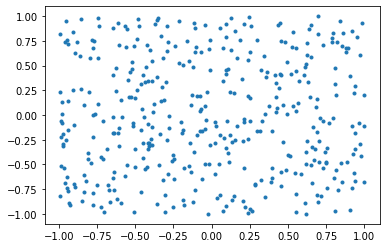

In [ ]:
plt.plot(Q[:,0], Q[:,1], '.')

In [ ]:
fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-1.5, 1.5))
ax.set_ylim((-1.5, 1.5))

points, = ax.plot(Q[:,0], Q[:,1],'.')

def rotate_figure(c, mp, puntos):
  R = rotacionPivote(0.7, 0.5, np.pi*c/60)
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos

# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(Q, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

In [ ]:
def rotacionPivoteX(h, k, s, ang):
    T1 = traslacion(-h, -k, s)
    R = rotacionX(ang)
    T2 = traslacion(h, k, 0)
    return np.matmul(np.matmul(T1, R), T2) 

fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-1.5, 1.5))
ax.set_ylim((-1.5, 3.5))

points, = ax.plot(Q[:,0], Q[:,1],'.')

def rotate_figure(c, mp, puntos):
  R = rotacionPivoteX(1, 1, 0, np.pi*c/60)
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos

# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(Q, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

# Cambio de escala con punto fijo

$$ S_{fijo} = T^{-1}(-h, -k, 0)\cdot S(s_x, s_y, s_z) \cdot T(h, k, 0) $$


In [ ]:
def escalaFijo(h, k, s):
    T1 = traslacion(-h, -k, 0)
    S = escala(s,s,s)
    T2 = traslacion(h, k, 0)
    return np.matmul(np.matmul(T1, S), T2) 

M = escalaFijo(-1, 0.5, 1.05)
M

array([[ 1.05 ,  0.   ,  0.   ,  0.   ],
       [ 0.   ,  1.05 ,  0.   ,  0.   ],
       [ 0.   ,  0.   ,  1.05 ,  0.   ],
       [ 0.05 , -0.025,  0.   ,  1.   ]])

In [ ]:
fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-2, 15))
ax.set_ylim((-2, 15))
points, = ax.plot(P[:,0], P[:,1])

def rotate_figure(c, mp, puntos):
  S = escalaFijo(0, 1, 1.02**c)
  P1 = np.matmul(mp, S)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos

# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(P, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

# Reflejo con respecto a una recta

$$ X_{linea} = T^{-1}(-h, -k, 0) \cdot R^{-1}(-ang) X_x R(ang) T(h, k, 0)$$


## Ejercicio:

> - Hallar e implementar una matriz de transformación que permita reflejar un objeto 2D al otro lado de una línea imaginaria dado por dos puntos. Utilice la composición de las transformaciones básicas. 

(2, -6)

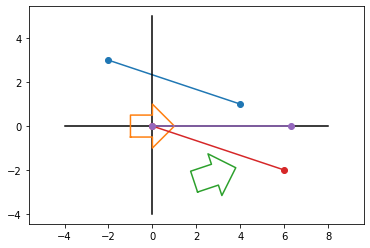

In [ ]:
recta = np.array([[-2, 3, 0, 1], [4, 1, 0, 1]])
plt.plot(recta[:,0], recta[:,1], 'o-') # línea del punto 1 al punto 2
plt.plot([-4, 8], [0, 0], 'k') # eje x
plt.plot([0, 0], [-4, 5], 'k') # eje x
plt.plot(P[:,0], P[:,1])

T1 = traslacion(-recta[0,0], -recta[0,1], 0)
r2 = np.matmul(recta, T1)
ang = np.arctan((recta[0,1]-recta[1,1])/(recta[0,0]-recta[1,0]))

R1 = rotacion(-ang)
M  = np.matmul(T1, R1)
P1 = np.matmul(P, M)
r3 = np.matmul(r2, R1)
plt.plot(P1[:,0], P1[:,1])
plt.plot(r2[:,0], r2[:, 1], 'o-') # línea del punto 1 al punto 2
plt.plot(r3[:,0], r3[:, 1], 'o-') # línea del punto 1 al punto 2
plt.axis('equal')
recta[0,1]-recta[1,1], recta[0,0]-recta[1,0]

# Transformada de Rotación Libre 3D
> 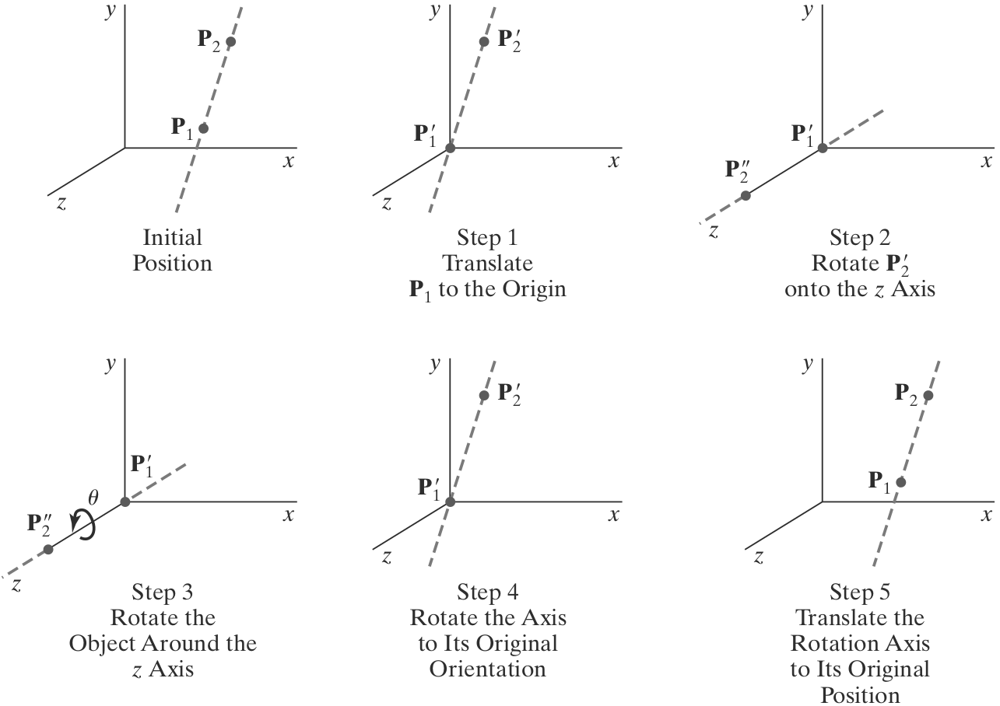



## Paso a paso de la matriz de rotación libre en 3D

> 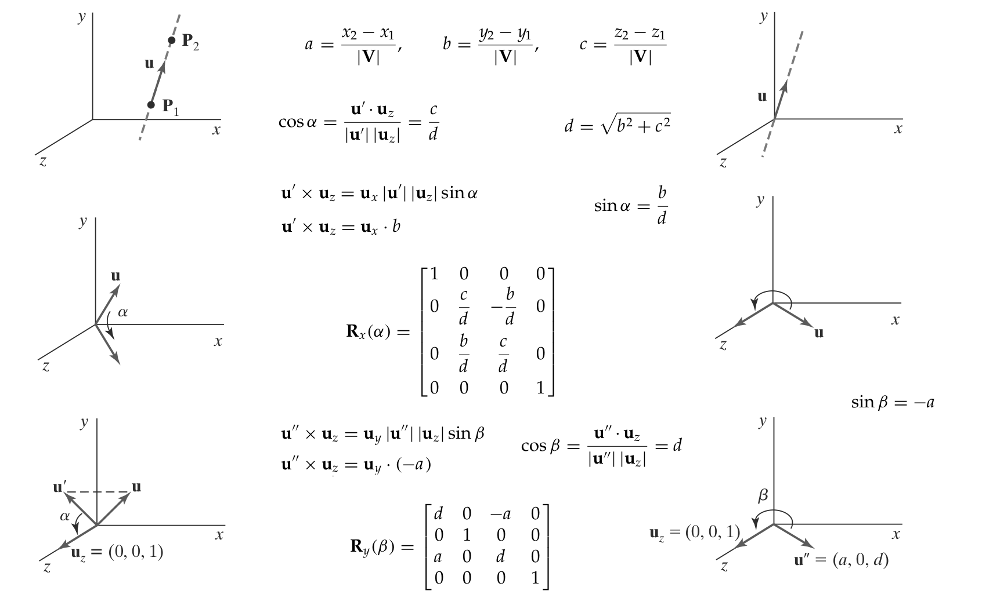

In [ ]:
def rotacion_libre(x1, y1, z1, x2, y2, z2, ang):
    p1 = np.array([x1, y1, z1])
    p2 = np.array([x2, y2, z2])

    V = (p2-p1)
    u = V / np.linalg.norm(V)
    a, b, c = u[0], u[1], u[2]
    d = (a**2 + b**2)**0.5
    Rx = np.array([[1,   0,    0, 0],
                   [0, c/d, -b/d, 0],
                   [0, b/d,  c/d, 0],
                   [0,   0,    0, 1]])
    Ry = np.array([[d, 0,-a, 0],
                   [0, 1, 0, 0],
                   [a, 0, d, 0],
                   [0, 0, 0, 1]])
    Rz = rotacion(ang)
    T1 = traslacion(-x1, -y1, -z1)
    T  = traslacion(x1, y1, z1)
    return np.matmul(np.matmul(np.matmul(np.matmul(np.matmul(np.matmul(T1,Rx.T),Ry.T),Rz),Ry),Rx),T)


V = np.array([[-1, -1, -5, 1], [-1, -1, 5, 1], [-1, -1, -1, 1], [-1, -1, 1, 1], [1, -1, 1, 1], [1, -1, -1, 1], [-1, -1, -1, 1], 
     [0, 1, 0, 1], [1, -1, 1, 1], [-1, -1, 1, 1], [0, 1, 0, 1], [1, -1, -1, 1], [1, -1, 5, 1], [1, -1, -5, 1]])
R = rotacion_libre(1.5,-1,1, 0.5,1,1, 30)


In [ ]:
# animación de rotación libre
from matplotlib import animation, rc

fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-2, 3))
ax.set_ylim((-2, 3))
points, = ax.plot(V[:,0], V[:,1])

def rotate_figure(c, mp, puntos):
  R = rotacion_libre(2,-2,0, 1, 1,0, np.pi*c/60)
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos
# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(V, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

# __Transformación entre dos sistemas de coordenadas 2D__

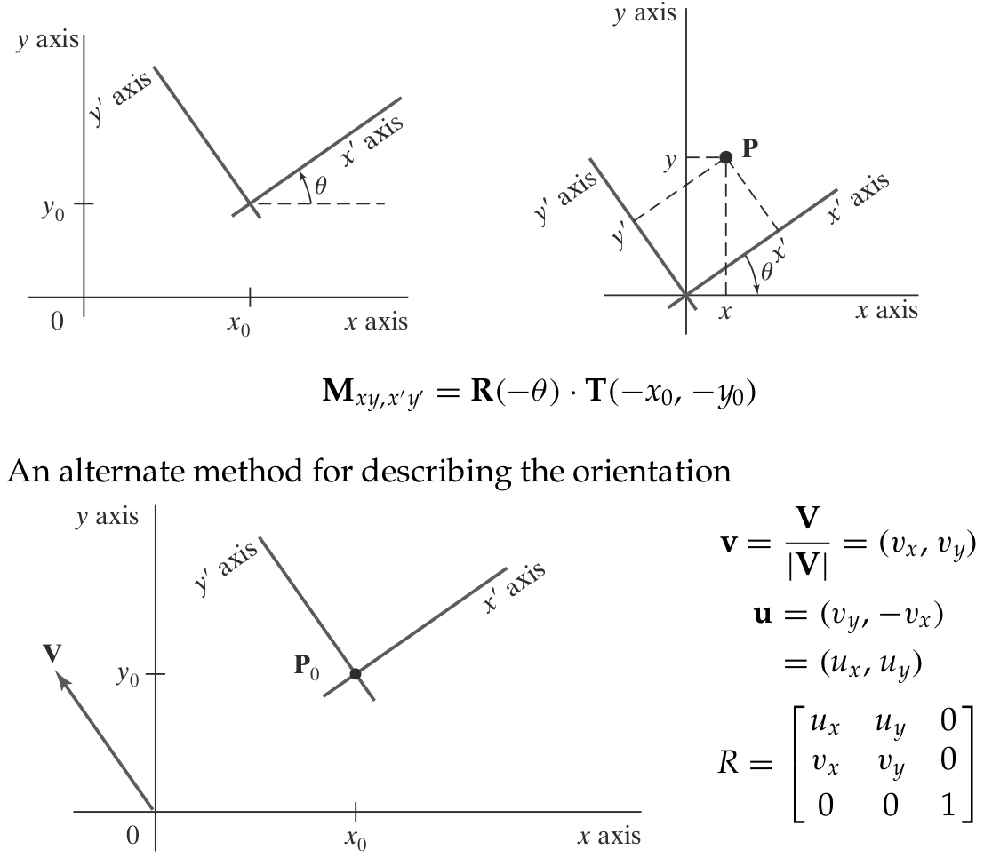

# __Proyección de la cámara__



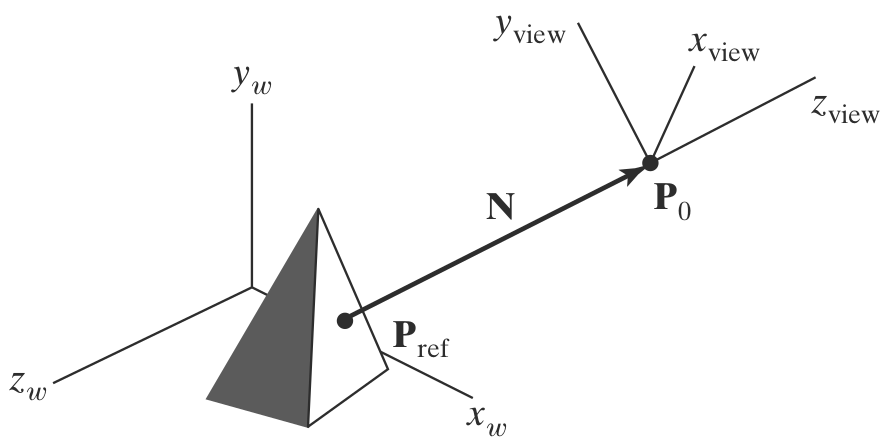

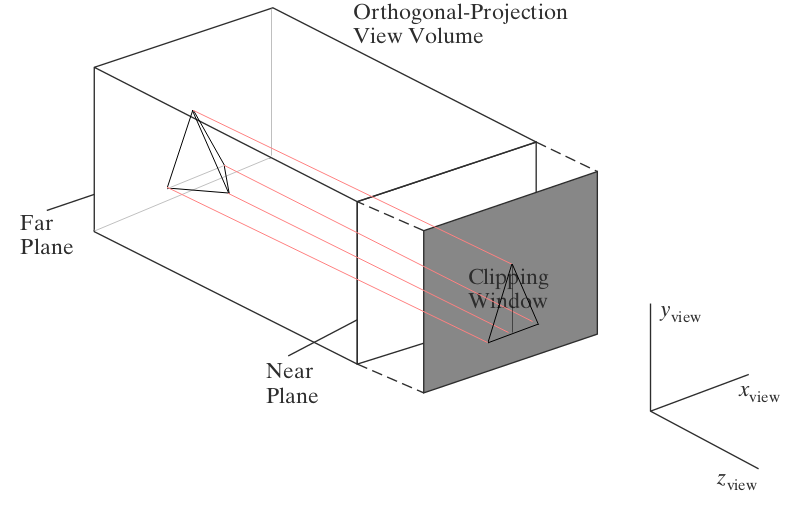

In [ ]:
import numpy as np
def camara(Po, Pref=np.array([0,0,0]), V=np.array([0, 1, 0])):
    T = traslacion(-Po[0], -Po[1], -Po[2])
    N = Po-Pref
    n = N / np.linalg.norm(N)
    v = V / np.linalg.norm(V)
    U = np.cross(v, n)
    u = U / np.linalg.norm(U)
    v = np.cross(n, u)
    R = np.array([[u[0], u[1], u[2], 0], 
                  [v[0], v[1], v[2], 0], 
                  [n[0], n[1], n[2], 0], 
                  [  0,    0,   0,   1]]).T
    return np.matmul(T, R)

In [ ]:
K = camara(np.array([3,1,2]), np.array([0,0,0]))
K

array([[ 5.54700196e-01, -2.22374795e-01,  8.01783726e-01,
         0.00000000e+00],
       [ 0.00000000e+00,  9.63624112e-01,  2.67261242e-01,
         0.00000000e+00],
       [-8.32050294e-01, -1.48249863e-01,  5.34522484e-01,
         0.00000000e+00],
       [ 0.00000000e+00, -5.55111512e-17, -3.74165739e+00,
         1.00000000e+00]])

[[ -0.13018891  -0.46607731   0.87511301   0.        ]
 [  0.39056673   0.7871528    0.47733437   0.        ]
 [ -0.91132238   0.40393367   0.07955573   0.        ]
 [ -0.65094455   0.72500916 -11.13780198   1.        ]]


(-6.1969921626872155,
 4.113969586994035,
 -2.7964638841419025,
 2.672176600402263)

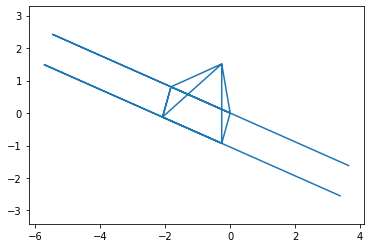

In [ ]:
pos = np.array([10,5,0])
dir = np.array([-1,-1,-1])
vert = np.array([-1,2,1])
K = camara(pos, dir, vert)
print(K)
V1 = np.matmul(V, K)
plt.plot(V1[:,0], V1[:,1])
plt.axis('equal')

In [ ]:
# Animación de la cámara
from matplotlib import animation, rc

fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-1.5, 1.5))
ax.set_ylim((-2.5, 1.2))
points, = ax.plot(V[:,0], V[:,1])

def rotate_figure(c, mp, puntos):
  R = camara(np.array([(-6+c/10)*2, 10, 0.1]), np.array([0,0,0]))
  #R = camara(np.array([np.cos(c*np.pi/60), (-6+c/10)/2, np.sin(c*np.pi/60)]), np.array([0,1,0]))
  P1 = np.matmul(mp, R)
  puntos.set_data(P1[:,0], P1[:,1])   
  return puntos
# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 120, fargs=(V, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

# __Proyección de perspectiva__

> - Esquema general de la proyección en perspectiva de la cámara


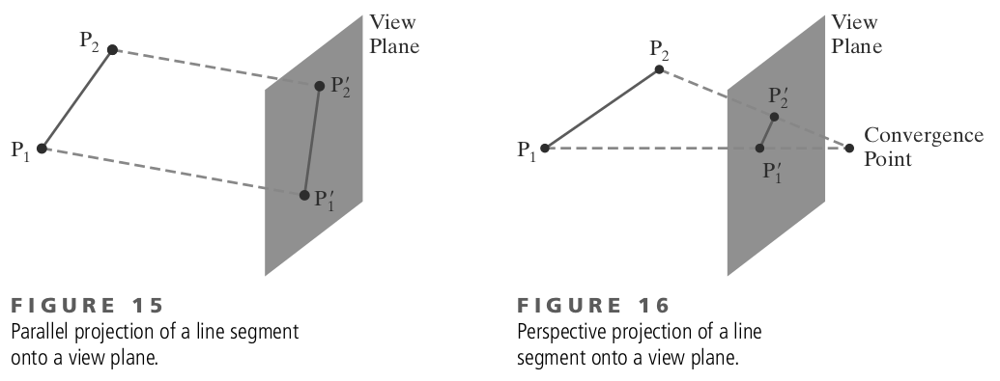


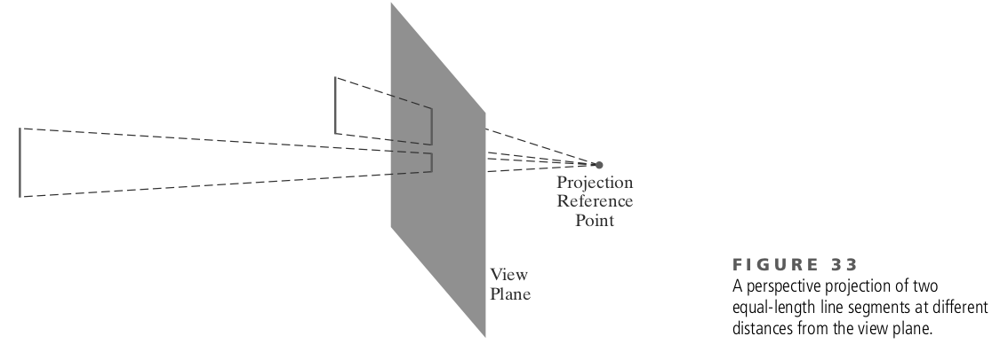

## __Ecuación general de la proyección__

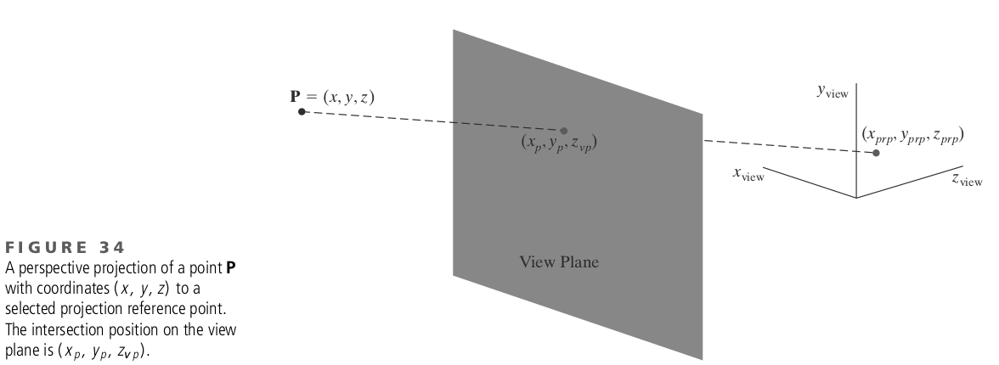

> - Recta que pasa por los puntos $P$ y por $P_{prp}$
> - ecuaciones paramétricas de la recta para:   $0 \le u \le 1$: <br><br>
$$ x' = x - (x-x_{prp})u $$
$$ y' = y - (y-y_{prp})u $$
$$ z' = z - (z-z_{prp})u $$

> - Haciendo $u=0$ se obtiene $P$
> - Haciendo $u=1$ se obtiene $P_{prp}$

---

> - El objetivo es calcular el punto en el plano de visualización es decir $(x_p, y_p, z_{vp})$. Para esto se necesita despejar $u$:
$$ z_{vp} = z - (z-z_{prp})u$$
$$ u = \frac{z_{vp}-z}{z_{prp}-z}$$

---

> - Reemplazando en los puntos : $x_p, y_p$ se obtienen las __ecuaciones generales de la proyección en perspectiva__:
$$ x_p = x \left( \frac{z_{prp}-z_{vp}}{z_{prp}-z} \right) + x_{prp} \left( \frac{z_{vp}-z}{z_{prp}-z} \right) $$

$$ y_p = y \left( \frac{z_{prp}-z_{vp}}{z_{prp}-z} \right) + y_{prp} \left( \frac{z_{vp}-z}{z_{prp}-z} \right) $$




## __Matrix de proyección en perspectiva__

> - Hacemos $h = z_{prp}-z$
$$ x_p = \frac{x_h}{h}, \quad \quad y_p = \frac{y_h}{h}$$

> - Así las ecuaciones generales quedan como:
$$ x_h = x(z_{prp}-z_{vp}) + x_{prp}(z_{vp}-z)$$
$$ y_h = y(z_{prp}-z_{vp}) + y_{prp}(z_{vp}-z)$$

---

$$P_h = M_{pers} \cdot P$$

---


$$
\begin{bmatrix}
 x_h\\ 
 y_h\\ 
 z_{vp}\\ 
 h 
\end{bmatrix} = 
\begin{bmatrix}
 (z_{prp}-z_{vp}) &  0&  -x_{prp}& x_{prp}z_{vp} \\ 
 0&  (z_{prp}-z_{vp})&  -y_{prp}& y_{prp}z_{vp}\\ 
 0&  0&  s& t\\ 
 0&  0&  -1& z_{prp}
\end{bmatrix}\cdot
\begin{bmatrix}
 x\\ 
 y\\ 
 z\\ 
 1 
\end{bmatrix}
$$

## __Frustum (proyección en perspectiva simétrica)__


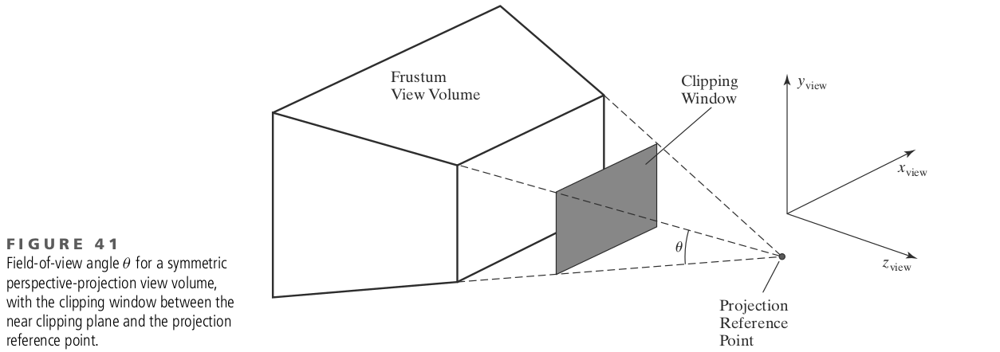

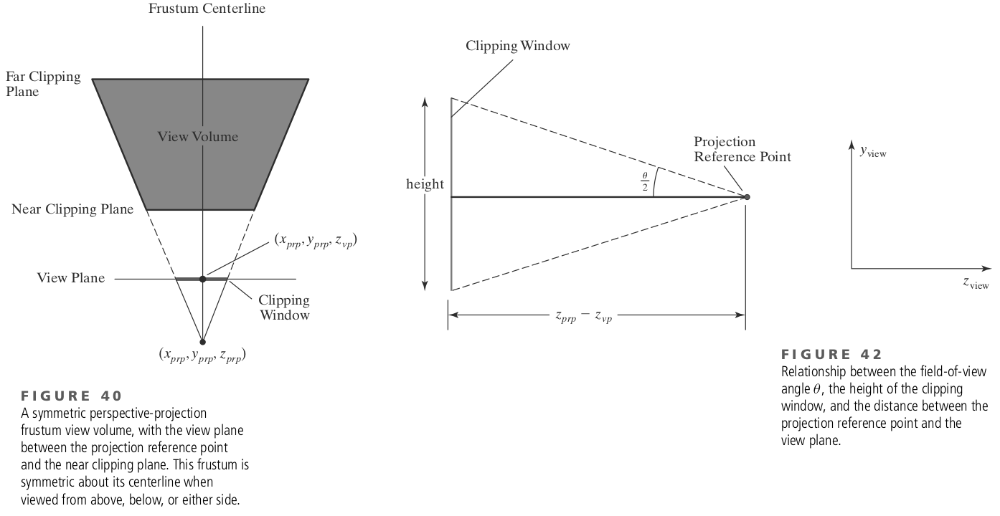

# __Parámetros de la cámara__

> - Ángulo de visión
- Aspecto
- Ubicación
- Punto de visión
- Orientación de la cámara

---

> - Ángulo de visión, apertura vertical
$$ xw_{min} = x_{prp} - \frac{width}{2}, \quad \quad xw_{max} = x_{prp} + \frac{width}{2}$$
$$ yw_{min} = y_{prp} - \frac{height}{2}, \quad \quad yw_{max} = y_{prp} + \frac{height}{2}$$

$$ \tan \left( \frac{\theta}{2} \right) = \frac{height/2}{z_{prp}-z_{vp}}$$

> - Despejando $z_{prp}- z_{vp}$ se tiene:

$$ z_{prp}- z_{vp} = \frac{height}{2} \cot \left( \frac{\theta}{2} \right)$$


$$ z_{prp}- z_{vp} = \frac{width}{2\cdot aspect} \cot \left( \frac{\theta}{2} \right)$$


## __Matriz del frustum__

> - Usando la matriz de proyección en perspectiva y asumiendo el plano de visualización en el plano cercano del frustum y el punto de proyección en el origen, queda:

$$ M_{frustum} = 
\begin{bmatrix}
 \frac{cot(\theta/2)}{aspect}  & 0  & 0 & 0 \\ 
 0 & \cot(\theta/2)  & 0 & 0 \\ 
 0&  0& \frac{z_{near}+z_{far}}{z_{near}-z_{far}}  & -\frac{2 z_{near} z_{far}}{z_{near}-z_{far}} \\ 
 0& 0 & -1 & 0
\end{bmatrix}
$$



In [ ]:
# matriz de perpectiva
def perspectiva(ang, aspect, near, far):
    cot = 1 / np.tan(ang*np.pi/360)
    sc  = (near+far)/(near-far)
    tr  = -2*near*far/(far-near)
    return np.array([[cot/aspect, 0,     0,   0],
                     [    0,     cot,    0,   0],
                     [    0,      0,    sc,  tr],
                     [    0,      0,    -1,   0]]).T

def adjust_persp(V):
    V[:,0] = -V[:,0]/V[:,2] 
    V[:,1] = -V[:,1]/V[:,2] 
    return V

## Algoritmo perspectiva
> - Construir la escena ==> produce (vértices e índices)
- Generar la matriz de la vista (model_view)
- Generar la matriz de perspectiva de la cámara 
- Generar la matriz de la cámara: Multiplicar el model_view y la perspectiva
- Transformar los vertices con la matriz de la cámara
- Ajustar los vértices dividiendo cada uno por $-z$
- Convertir los vértices a coordenadas de la pantalla: escala (factor) y traslación (width/2, height/2)
- Pintar triángulos de la escena usando vértices e índices


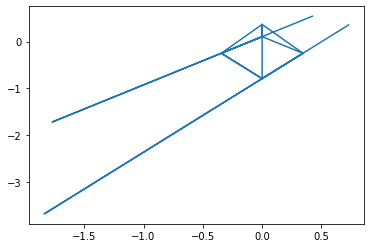

In [ ]:
mv = camara(np.array([2,3,2]), np.array([0,0,0]), np.array([0,-1,0]))
mp = perspectiva(60, 1.5, 0.1, 10)
mc = np.matmul(mv, mp) 
V1 = np.matmul(V, mc)
V2 = adjust_persp(V1)
plt.plot(V2[:,0], V2[:,1])
#plt.axis([-5, 5, -3, 3])

In [ ]:
# Animación de perspectiva
from matplotlib import animation, rc

fig, ax = plt.subplots()
plt.close()
ax.set_xlim((-6.5, 6.5))
ax.set_ylim((-9.0, 2.5))
points, = ax.plot(V[:,0], V[:,1])

def rotate_figure(c, P, puntos):
    mv = camara(np.array([-5+c/6, 0.5, 2]), np.array([100,0,2]), np.array([0,-1,0]))
    mp = perspectiva(30, 1.5, 0.1, 10)
    mc = np.matmul(mv, mp) 
    P1 = np.matmul(P, mc)
    P2 = adjust_persp(P1)   
    puntos.set_data(P2[:,0], P2[:,1])   
    return puntos
# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 60, fargs=(V, points), interval=100, blit=False)

rc('animation', html='jshtml')
anim

> Ploblema de la animación
- Aún se tiene el problema de recorte
- Las líneas atrás del plano de visualización también se proyectan

# Juntar todo

> - Funciones para crear objetos
- Funciones para transformar objetos
- Crear escena {vértices, índices} función de agregar objetos a la escena
- Convertir a coordenadas de pantalla
- Funciones de TG
- Model view
- Matriz de perspectiva
- Corrección de perspectiva

---

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def traslacion(dx, dy, dz):
    return np.array([[1, 0, 0, dx], 
                     [0, 1, 0, dy], 
                     [0, 0, 1, dz], 
                     [0, 0, 0,  1]]).T

def rotacion(ang):
    c = np.cos(ang)
    s = np.sin(ang)
    return np.array([[c, -s, 0, 0], 
                     [s,  c, 0, 0], 
                     [0,  0, 1, 0], 
                     [0,  0, 0, 1]]).T

def rotacionX(ang):
    c = np.cos(ang)
    s = np.sin(ang)
    return np.array([[1, 0,  0, 0], 
                     [0, c, -s, 0], 
                     [0, s,  c, 0], 
                     [0, 0,  0, 1]]).T

def rotacionY(ang):
    c = np.cos(ang)
    s = np.sin(ang)
    return np.array([[c, 0, -s, 0], 
                     [0, 1,  0, 0], 
                     [s, 0,  c, 0], 
                     [0, 0,  0, 1]]).T

def escala(sx, sy, sz):
    return np.array([[sx,  0,  0, 0], 
                     [ 0, sy,  0, 0], 
                     [ 0,  0, sz, 0], 
                     [ 0,  0,  0, 1]]).T

def reflexionX():
    return np.array([[1,  0, 0, 0], 
                     [0, -1, 0, 0], 
                     [0,  0, 1, 0], 
                     [0,  0, 0, 1]]).T

def reflexionY():
    return np.array([[-1, 0, 0, 0], 
                     [ 0, 1, 0, 0], 
                     [ 0, 0, 1, 0], 
                     [ 0, 0, 0, 1]]).T

def rotacionPivote(h, k, ang):
    T1 = traslacion(-h, -k, 0)
    R = rotacion(ang)
    T2 = traslacion(h, k, 0)
    return np.matmul(np.matmul(T1, R), T2) 

def escalaFijo(h, k, s):
    T1 = traslacion(-h, -k, 0)
    S = escala(s,s,s)
    T2 = traslacion(h, k, 0)
    return np.matmul(np.matmul(T1, S), T2) 

def camara(Po, Pref=np.array([0,0,0]), V=np.array([0, 1, 0])):
    T = traslacion(-Po[0], -Po[1], -Po[2])
    N = Po-Pref
    n = N / np.linalg.norm(N)
    v = V / np.linalg.norm(V)
    U = np.cross(v, n)
    u = U / np.linalg.norm(U)
    v = np.cross(n, u)
    R = np.array([[u[0], u[1], u[2], 0], 
                  [v[0], v[1], v[2], 0], 
                  [n[0], n[1], n[2], 0], 
                  [  0,    0,   0,   1]]).T
    return np.matmul(T, R)

def perspectiva(ang, aspect, near, far):
    cot = 1 / np.tan(ang*np.pi/360)
    sc  = (near+far)/(near-far)
    tr  = -2*near*far/(far-near)
    return np.array([[cot/aspect, 0,     0,   0],
                     [    0,     cot,    0,   0],
                     [    0,      0,    sc,  tr],
                     [    0,      0,    -1,   0]]).T

def adjust_persp(V):
    V[:,0] = -V[:,0]/V[:,2] 
    V[:,1] = -V[:,1]/V[:,2] 
    return V    


## __Modificar primitivas gráficas__

> - Generar una matriz de vértices y de índices
- Dibujar triángulos a un plot 
- Filtrar los triángulos que se pintan

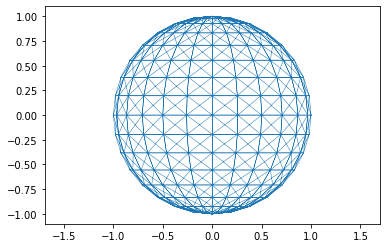

In [ ]:
def sphere(lats, lons):
    vert=[]
    ndx=[]
    dt = 2*np.pi/lons
    dp = np.pi/lats
    for i in range(lats+1):
        for j in range(lons):
            vert.append([np.cos(j*dt)*np.sin(i*dp),
                         np.cos(i*dp), 
                         np.sin(j*dt)*np.sin(i*dp), 
                         1])
    for i in range(lats):
        for j in range(lons): 
            ndx.append([i*lons+j, (i+1)*lons+(j+1)%lons, (i+1)*lons+j])
            ndx.append([i*lons+j, (i+0)*lons+(j+1)%lons, (i+1)*lons+(j+1)%lons])
    return np.array(vert), np.array(ndx, dtype='int32')

V, I = sphere(16,24)
plt.triplot(V[:,0], V[:,1], I, lw=0.5)
tt = plt.axis('equal')

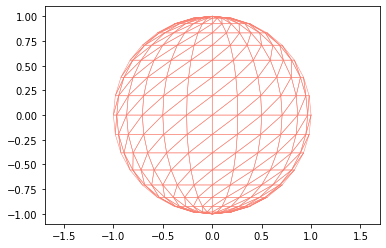

In [ ]:
def draw_triang(ax, V, I, kolor='firebrick'):
    for i in range(I.shape[0]):
        if(V[I[i,0],2]>=0 and V[I[i,1],2]>=0 and V[I[i,2],2]>=0):
            x0 = V[I[i,0],0]
            y0 = V[I[i,0],1]
            x1 = V[I[i,1],0]
            y1 = V[I[i,1],1]
            x2 = V[I[i,2],0]
            y2 = V[I[i,2],1]
            ax.plot([x0, x1, x2, x0], [y0, y1, y2, y0], lw=0.5, color=kolor)

fig, ax = plt.subplots()
ax.axis('equal')
draw_triang(ax, V, I, 'salmon')


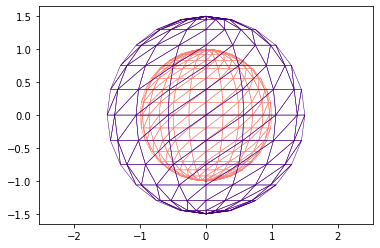

In [ ]:
V1, I1 = sphere(12,16)
Sc = escala(1.5, 1.5, 1.5)
V1 = np.matmul(V1, Sc)
fig, ax = plt.subplots()
ax.axis('equal')
draw_triang(ax, V, I, 'salmon')
draw_triang(ax, V1, I1, 'indigo')


In [ ]:
from matplotlib import animation, rc

fig, ax = plt.subplots()
plt.close()
graf, = ax.plot(V[:,0], V[:,1])

def rotate_figure(c, P, ax1):
    mv = camara(np.array([-5+c/6, 0.2, 0.2]), np.array([100, 0.2, 0.2]), np.array([0,-1,0]))
    mp = perspectiva(30, 1.5, 0.1, 10)
    mc = np.matmul(mv, mp) 
    P1 = np.matmul(P, mc)
    P2 = adjust_persp(P1)   
    ax.clear()
    ax.set_xlim((-1.5, 1.5))
    ax.set_ylim((-1.5, 1.5))
    draw_triang(ax, P2, I)
    draw_triang(ax, P2, I)
    return ax1
# animation function: this is called sequentially
anim = animation.FuncAnimation(fig, rotate_figure, 60, fargs=(V, graf), interval=100, blit=False)

rc('animation', html='jshtml')
anim

### __Usando la función triplot__
> - Pintando los triángulos con z mayor a un valor

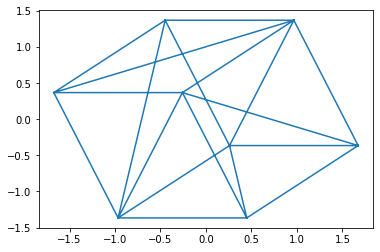

In [ ]:
def cube():
    vert = np.array([[-1,-1,-1,1],[1,-1,-1,1],[1,1,-1,1],[-1,1,-1,1],[-1,-1,1,1],[1,-1,1,1],[1,1,1,1],[-1,1,1,1]])
    ndx  = np.array([[0,1,2],[0,2,3],[0,1,5],[0,5,4],[1,2,6],[1,6,5],[2,3,7],[2,7,6],[3,0,4],[3,4,7],[4,5,6],[4,6,7]])
    return vert, ndx

#pal = np.array([x/12+0.01 for x in range(12)])

V, I = cube()
R1 = rotacionX(np.pi/6)
R2 = rotacionY(np.pi/4)
V1 = np.matmul(V, np.matmul(R1, R2))

#plt.tripcolor(V1[:,0], V1[:,1], I, facecolors=pal, edgecolor='k', alpha=0.4)
plt.triplot(V1[:,0], V1[:,1], I)

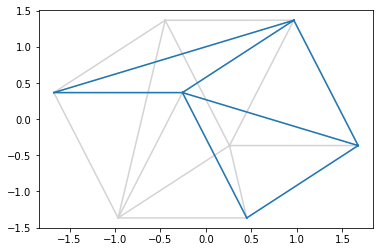

In [ ]:
# filtrar los índices donde z es mayor a cero
nI = np.min(V1[I][:,:,2], axis=1) > -0.3
plt.triplot(V1[:,0], V1[:,1], I, color='lightgray')
plt.triplot(V1[:,0], V1[:,1], I[nI])

# __Pseudo-código de las primitivas gráficas__

>- La generación de primitivas gráficas, por ejemplo el cubo, el plano y la esfera, deben tener el mismo mecanismo de uso, para que puedan ser utilizadas por el motor gráfico de la misma forma. Sin importar la cantidad de primitivas que se generen. 
- En este caso, la idea es hacer dos arreglos, uno para vértices y otro para índices (sobre el arreglo de vértices) para formar los triángulos. 
- A continuación se muestra el pseudo-código de estas primitvas:

> En la primitiva del cubo los vértices y los índices están quemados

```
función cube():
    vert = [-1,-1,-1,1,-1,-1,1,1,-1,-1,1,-1,-1,-1,1,1,-1,1,1,1,1,-1,1,1]
    ndx = [0,1,2,0,2,3,0,1,5,0,5,4,1,2,6,1,6,5,2,3,7,2,7,6,3,0,4,3,4,7,4,5,6,4,6,7]
    devolver vert, ndx
```

> - La primitiva del plano recibe la cantidad de divisiones

```
función plane(divs):
    vert = []
    ndx  = []
    
    para i=0 hasta divs:
        para j=0 hasta divs:
            vert.add(j/divs*2-1)
            vert.add(i/divs*2-1)
            vert.add(0.0)
        end-para 
    end-para 

    para i=0 hasta divs-1:
        para j=0 hasta divs-1:
            ndx.add(i*(divs+1)+j)
            ndx.add((i+1)*(divs+1)+j+1)
            ndx.add((i+1)*(divs+1)+j)
            ndx.add(i*(divs+1)+j)
            ndx.add(i*(divs+1)+j+1)
            ndx.add((i+1)*(divs+1)+j+1)
        end-para 
    end-para 

    devolver vert, ndx
```
> La primitiva de la esfera es un algoritmo muy similar al del plano.

```
función sphere(lats, lons):
    vert = []
    ndx  = []
    dt = 2*pi/lons
    dp = pi/lats

    para i=0 hasta lats:
        para j=0 hasta lons-1:
            vert.add(cos(j*dt)*sin(i*dp))
            vert.add(cos(i*dp))
            vert.add(sin(j*dt)*sin(i*dp))
        end-para 
    end-para 

    para i=0 hasta lats-1:
        para j=0 hasta lons-1:
            ndx.add(i*lons+j)
            ndx.add((i+1)*lons+(j+1)%lons)
            ndx.add((i+1)*lons+j)
            ndx.add(i*lons+j)
            ndx.add(i*lons+(j+1)%lons)
            ndx.add((i+1)*lons+(j+1)%lons)
        end-para 
    end-para 

    devolver vert, ndx
```



In [ ]:
ver = [1,1,1, 2,2,2, 3,3,3, 4,4,4, 5,5,5]
mat = [1,0,0,0, 0,1,0,0, 0,0,1,0, -3,-2,-1,1]
def apply(v, m):
    N = len(v)
    for n in range(0,N,3):
        x = v[n+0]*m[0] + v[n+1]*m[4] + v[n+2]*m[8]  + m[12]
        y = v[n+0]*m[1] + v[n+1]*m[5] + v[n+2]*m[9]  + m[13]
        z = v[n+0]*m[2] + v[n+1]*m[6] + v[n+2]*m[10] + m[14]
        v[n], v[n+1], v[n+2] = x, y, z
        print(x, y, z)

apply(ver, mat)
ver

84


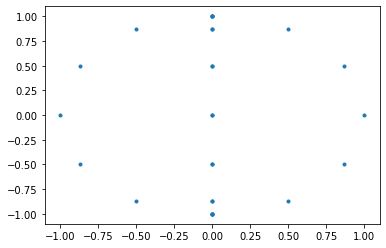

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def sphere(lats, lons):
    v=[]
    ndx=[]
    dt = 2*np.pi/lons
    dp = np.pi/lats
    for i in range(lats+1):
        for j in range(lons):
            v.append(np.cos(j*dt)*np.sin(i*dp))
            v.append(np.cos(i*dp))
            v.append(np.sin(j*dt)*np.sin(i*dp))
            #print(i, j, np.cos(j*dp))
    for i in range(lats):
        for j in range(lons): 
            ndx.append(i*lons+j)
            ndx.append((i+1)*lons+(j+1)%lons)
            ndx.append((i+1)*lons+j)
            ndx.append(i*lons+j)
            ndx.append(i*lons+(j+1)%lons)
            ndx.append((i+1)*lons+(j+1)%lons)
    return v, ndx

v,n = sphere(6, 4)
print(len(v))
v = np.array(v).reshape((len(v)//3,3))
n = np.array(n).reshape((len(n)//3,3))
plt.plot(v[:,0], v[:,1], '.')

# Trabajo Cámara en perspectiva

El objetivo del trabajo es utilizar el material que se ha compartido en los cuadernos de
computación gráfica: Primitivas gráficas y transformaciones geométricas, para construir una
escena y generar una animación.
El trabajo consta de los siguientes elementos:

1. Construir una escena: plano y elementos sobre el plano (2
   pts)
   La escena consta de un plano de 20 segmentos, y las líneas de una serie de primitivas
   gráficas de diferente color (como cubo, pirámide, cono, cilindro, esfera, toroide, etc) el
   diseño de la escena es libre y los elementos se pueden repetir. El objetivo es recorrer los
   diferentes elementos de la escena
2. Construir una cámara en perspectiva y generar un
   recorrido de la cámara en primera persona (2 pts)
   El programador debe diseñar un recorrido suave de la cámara en primera persona que se
   mueva sobre el plano y pase al lado de los objetos. Todo el tiempo se debe controlar la
   posición y hacia donde está mirando la cámara. Si un triángulo del objeto queda detrás de la
   cámara no se debe pintar.
3. Producir una animación. (1 pts)
   La animación se mueve todo el tiempo, no debe quedar la escena en blanco en ningún
   momento y debe tener al menos 200 cuadros.
